# 📘 Big Data Analytics Mini Project  
## Property Based Crime Analysis(2001-2010)  

---

### Submitted By:  
Name: S.MONIS ,
Roll No: 2211CS010502 ,
Section: S2-67 ,
Course: Big Data Analytics (BDA) Minor Project , 
Mini Project Title: Property Based Crime Analysis(2001-2010) .


## 📊 Dataset Description-Property Stolen & Recovered (Crime Head)(2001-2010)
```
The dataset contains comprehensive records of property crimes reported across all Indian states and union territories from 2001 to 2010. It includes detailed information about various property crime categories such as burglary, theft, robbery, criminal breach of trust, dacoity, and other property-related offenses. For each crime incident, the dataset tracks both the stolen and recovered property, providing separate counts for the number of cases and the monetary value involved. Key columns include geographical information (state/union territory names), year of occurrence, crime category classification, number of property stolen cases, value of stolen property, number of property recovered cases, and value of recovered property. This structured dataset enables analysis of crime patterns over time, regional comparisons of crime rates, and evaluation of law enforcement effectiveness in recovering stolen assets across different parts of India during this decade-long period.```


## 📖 Project Overview

This project analyzes property crime data across India from 2001 to 2010 using Big Data Analytics with PySpark. We examined a comprehensive dataset containing information about different types of property crimes including burglary, theft, robbery, and criminal breach of trust across all Indian states and union territories. 

The main goal was to understand crime patterns, identify high-risk regions, and evaluate how effectively stolen property was being recovered by law enforcement agencies.

We processed the data through multiple stages: first cleaning and preparing the dataset, then calculating key metrics like recovery rates to measure police efficiency. Our analysis revealed which states had the highest number of property crimes, which regions were most successful at recovering stolen property, and how crime trends evolved over the ten-year period.

In [1]:
# Install required packages (run in terminal first)
# pip install pyspark pandas matplotlib seaborn plotly wordcloud scipy numpy jupyter

from pyspark.sql import SparkSession
from pyspark.sql.functions import *
from pyspark.sql.types import *
from pyspark.sql.window import Window
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd
import numpy as np
from wordcloud import WordCloud
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

# Set style for better visualizations
plt.style.use('seaborn-v0_8')
sns.set_palette("husl")

# Initialize Spark Session
spark = SparkSession.builder \
    .appName("PropertyCrimeAnalysis") \
    .config("spark.sql.adaptive.enabled", "true") \
    .config("spark.sql.adaptive.coalescePartitions.enabled", "true") \
    .getOrCreate()

spark.sparkContext.setLogLevel("ERROR")

# Load the dataset
df = spark.read.option("header", "true") \
    .option("inferSchema", "true") \
    .csv(r"C:\Users\monis_bfv4s0d\Downloads\10_Property_stolen_and_recovered.csv")

print("Dataset loaded successfully!")
print(f"Rows: {df.count()}, Columns: {len(df.columns)}")

Dataset loaded successfully!
Rows: 2449, Columns: 8


In [2]:
# Enhanced Data Quality Assessment with TABLES (No Visualizations)
def enhanced_data_quality_report_tables(df):
    print("=== ENHANCED DATA QUALITY REPORT - TABULAR VIEW ===")
    
    # Convert to pandas for analysis
    df_pd = df.toPandas()
    
    print("\n" + "="*60)
    print("1. DATASET OVERVIEW")
    print("="*60)
    
    # Basic dataset info
    print(f"Total Rows: {len(df_pd):,}")
    print(f"Total Columns: {len(df_pd.columns)}")
    print(f"Memory Usage: {df_pd.memory_usage(deep=True).sum() / 1024**2:.2f} MB")
    
    print("\n" + "="*60)
    print("2. MISSING VALUES ANALYSIS")
    print("="*60)
    
    # 1. Missing Values Table (replaces heatmap)
    missing_data = df_pd.isnull().sum()
    missing_percentage = (missing_data / len(df_pd)) * 100
    
    missing_table = pd.DataFrame({
        'Column_Name': missing_data.index,
        'Missing_Count': missing_data.values,
        'Missing_Percentage': missing_percentage.values,
        'Data_Type': df_pd.dtypes.values
    })
    
    print("Missing Values by Column:")
    print(missing_table.to_string(index=False))
    
    # Summary of missing values
    total_missing = missing_data.sum()
    print(f"\nSUMMARY:")
    print(f"Total missing values: {total_missing:,}")
    print(f"Overall data completeness: {((1 - total_missing/df_pd.size) * 100):.2f}%")
    
    print("\n" + "="*60)
    print("3. DATA TYPES ANALYSIS")
    print("="*60)
    
    # 2. Data Types Table (replaces pie chart)
    data_types_summary = df_pd.dtypes.value_counts().reset_index()
    data_types_summary.columns = ['Data_Type', 'Count']
    data_types_summary['Percentage'] = (data_types_summary['Count'] / len(df_pd.columns)) * 100
    
    print("Data Types Distribution:")
    print(data_types_summary.to_string(index=False))
    
    # Detailed column types
    print("\nDetailed Column Information:")
    column_info = pd.DataFrame({
        'Column_Name': df_pd.columns,
        'Data_Type': df_pd.dtypes,
        'Non_Null_Count': df_pd.count().values,
        'Unique_Values': [df_pd[col].nunique() for col in df_pd.columns]
    })
    print(column_info.to_string(index=False))
    
    print("\n" + "="*60)
    print("4. NUMERIC COLUMNS STATISTICAL SUMMARY")
    print("="*60)
    
    # 3. Statistical Summary Tables (replaces histograms and box plots)
    numeric_cols = df_pd.select_dtypes(include=[np.number]).columns.tolist()
    
    if numeric_cols:
        print(f"Found {len(numeric_cols)} numeric columns:")
        
        # Basic statistics table
        basic_stats = df_pd[numeric_cols].describe().T
        basic_stats['range'] = basic_stats['max'] - basic_stats['min']
        basic_stats['cv'] = (basic_stats['std'] / basic_stats['mean']) * 100  # Coefficient of Variation
        
        print("\nBasic Statistics for Numeric Columns:")
        print(basic_stats.round(2).to_string())
        
        # Additional statistical measures
        print("\n" + "-"*40)
        print("ADDITIONAL STATISTICAL MEASURES")
        print("-"*40)
        
        advanced_stats = []
        for col in numeric_cols:
            data = df_pd[col].dropna()
            advanced_stats.append({
                'Column': col,
                'Skewness': f"{data.skew():.4f}",
                'Kurtosis': f"{data.kurtosis():.4f}",
                'Q1': f"{data.quantile(0.25):.2f}",
                'Median': f"{data.median():.2f}",
                'Q3': f"{data.quantile(0.75):.2f}",
                'IQR': f"{data.quantile(0.75) - data.quantile(0.25):.2f}",
                'Zeros_Count': f"{(data == 0).sum():,}",
                'Zeros_Percent': f"{((data == 0).sum() / len(data)) * 100:.2f}%"
            })
        
        advanced_stats_df = pd.DataFrame(advanced_stats)
        print(advanced_stats_df.to_string(index=False))
        
        # Outlier detection using IQR method
        print("\n" + "-"*40)
        print("OUTLIER DETECTION (IQR METHOD)")
        print("-"*40)
        
        outlier_info = []
        for col in numeric_cols:
            data = df_pd[col].dropna()
            Q1 = data.quantile(0.25)
            Q3 = data.quantile(0.75)
            IQR = Q3 - Q1
            lower_bound = Q1 - 1.5 * IQR
            upper_bound = Q3 + 1.5 * IQR
            
            outliers = data[(data < lower_bound) | (data > upper_bound)]
            outlier_info.append({
                'Column': col,
                'Outlier_Count': len(outliers),
                'Outlier_Percentage': f"{(len(outliers) / len(data)) * 100:.2f}%",
                'Min_Outlier': f"{outliers.min() if len(outliers) > 0 else 'N/A'}",
                'Max_Outlier': f"{outliers.max() if len(outliers) > 0 else 'N/A'}"
            })
        
        outlier_df = pd.DataFrame(outlier_info)
        print(outlier_df.to_string(index=False))
    
    else:
        print("No numeric columns found in the dataset.")
    
    print("\n" + "="*60)
    print("5. CATEGORICAL COLUMNS ANALYSIS")
    print("="*60)
    
    # Categorical columns analysis
    categorical_cols = df_pd.select_dtypes(include=['object']).columns.tolist()
    
    if categorical_cols:
        print(f"Found {len(categorical_cols)} categorical columns:")
        
        for col in categorical_cols:
            print(f"\n--- {col} ---")
            value_counts = df_pd[col].value_counts()
            print(f"Total unique values: {df_pd[col].nunique()}")
            print(f"Most frequent value: '{value_counts.index[0]}' (appears {value_counts.iloc[0]:,} times)")
            print(f"Least frequent value: '{value_counts.index[-1]}' (appears {value_counts.iloc[-1]:,} times)")
            
            # Show top 10 values
            print("\nTop 10 values:")
            top_10 = value_counts.head(10)
            for i, (val, count) in enumerate(top_10.items(), 1):
                percentage = (count / len(df_pd)) * 100
                print(f"  {i:2d}. {val:<30} {count:>8,} ({percentage:5.1f}%)")
    
    else:
        print("No categorical columns found in the dataset.")
    
    print("\n" + "="*60)
    print("6. DATA QUALITY SCORE")
    print("="*60)
    
    # Calculate overall data quality score
    total_cells = df_pd.size
    missing_cells = df_pd.isnull().sum().sum()
    duplicate_rows = df_pd.duplicated().sum()
    
    quality_score = ((total_cells - missing_cells) / total_cells) * 100
    uniqueness_score = ((len(df_pd) - duplicate_rows) / len(df_pd)) * 100
    
    print(f"Data Completeness Score: {quality_score:.2f}%")
    print(f"Data Uniqueness Score: {uniqueness_score:.2f}%")
    print(f"Duplicate Rows: {duplicate_rows:,}")
    print(f"Overall Quality Rating: {'EXCELLENT' if quality_score > 95 else 'GOOD' if quality_score > 85 else 'FAIR' if quality_score > 70 else 'POOR'}")

# Run the enhanced data quality report with tables
enhanced_data_quality_report_tables(df)

=== ENHANCED DATA QUALITY REPORT - TABULAR VIEW ===

1. DATASET OVERVIEW
Total Rows: 2,449
Total Columns: 8
Memory Usage: 0.52 MB

2. MISSING VALUES ANALYSIS
Missing Values by Column:
                Column_Name  Missing_Count  Missing_Percentage Data_Type
                  Area_Name              0                 0.0    object
                       Year              0                 0.0     int32
                 Group_Name              0                 0.0    object
             Sub_Group_Name              0                 0.0    object
   Cases_Property_Recovered              0                 0.0     int32
      Cases_Property_Stolen              0                 0.0     int32
Value_of_Property_Recovered              0                 0.0     int64
   Value_of_Property_Stolen              0                 0.0     int64

SUMMARY:
Total missing values: 0
Overall data completeness: 100.00%

3. DATA TYPES ANALYSIS
Data Types Distribution:
Data_Type  Count  Percentage
   object   

In [3]:
 # Data Cleaning (same as before)
def clean_data(df):
    df_clean = df.fillna({
        'Cases_Property_Recovered': 0,
        'Cases_Property_Stolen': 0,
        'Value_of_Property_Recovered': 0,
        'Value_of_Property_Stolen': 0,
        'Area_Name': 'Unknown',
        'Group_Name': 'Unknown',
        'Sub_Group_Name': 'Unknown'
    })
    
    df_clean = df_clean.dropDuplicates()
    
    df_clean = df_clean.withColumn(
        "Recovery_Rate_Cases", 
        when(col("Cases_Property_Stolen") > 0, 
             col("Cases_Property_Recovered") / col("Cases_Property_Stolen"))
        .otherwise(0)
    )
    
    df_clean = df_clean.withColumn(
        "Recovery_Rate_Value", 
        when(col("Value_of_Property_Stolen") > 0, 
             col("Value_of_Property_Recovered") / col("Value_of_Property_Stolen"))
        .otherwise(0)
    )
    
    return df_clean

df_clean = clean_data(df)
print("Data cleaning completed!")

Data cleaning completed!


In [4]:
# BEGINNER-FRIENDLY PROPERTY CRIME ANALYTICS

# 1. Basic Count Questions
print("1. BASIC COUNTS:")
print(f"Total crime records: {df.count():,}")
print(f"Number of crime types: {df.select('Group_Name').distinct().count()}")
print(f"Number of regions: {df.select('Area_Name').distinct().count()}")
print(f"Years covered: {df.select('Year').distinct().count()}")

# 2. Simple Grouping Questions
print("\n2. CRIME TYPE DISTRIBUTION:")
crime_types = df.groupBy('Group_Name').agg(
    sum('Cases_Property_Stolen').alias('Total_Cases')
).orderBy(desc('Total_Cases'))
print("Crime types by total cases:")
crime_types.show()

1. BASIC COUNTS:
Total crime records: 2,449
Number of crime types: 7
Number of regions: 35
Years covered: 10

2. CRIME TYPE DISTRIBUTION:
Crime types by total cases:
+--------------------+-----------+
|          Group_Name|Total_Cases|
+--------------------+-----------+
|      Total Property|    4187068|
|    Theft - Property|    2742941|
| Burglary - Property|     900772|
|Other heads of Pr...|     204914|
|  Robbery - Property|     187125|
|Criminal Breach o...|     103164|
|   Dacoity -Property|      48178|
+--------------------+-----------+



=== COMPREHENSIVE VISUALIZATION ANALYSIS ===

1. Crime Type Distribution Analysis


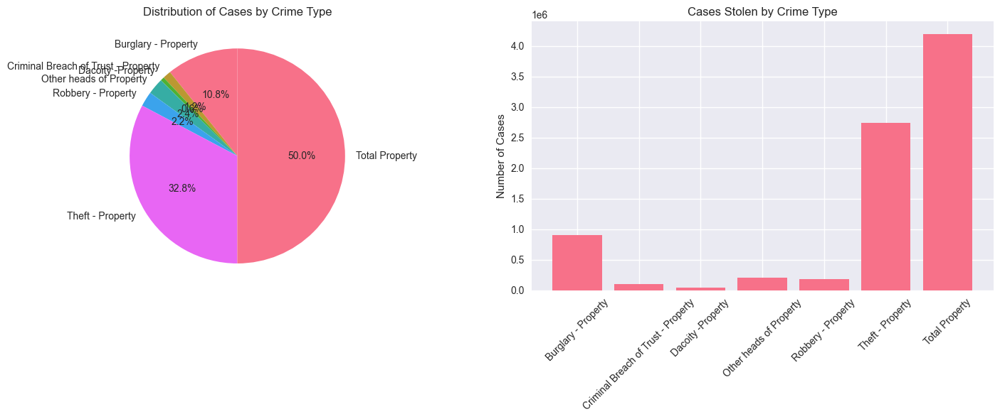


2. Yearly Trends Analysis


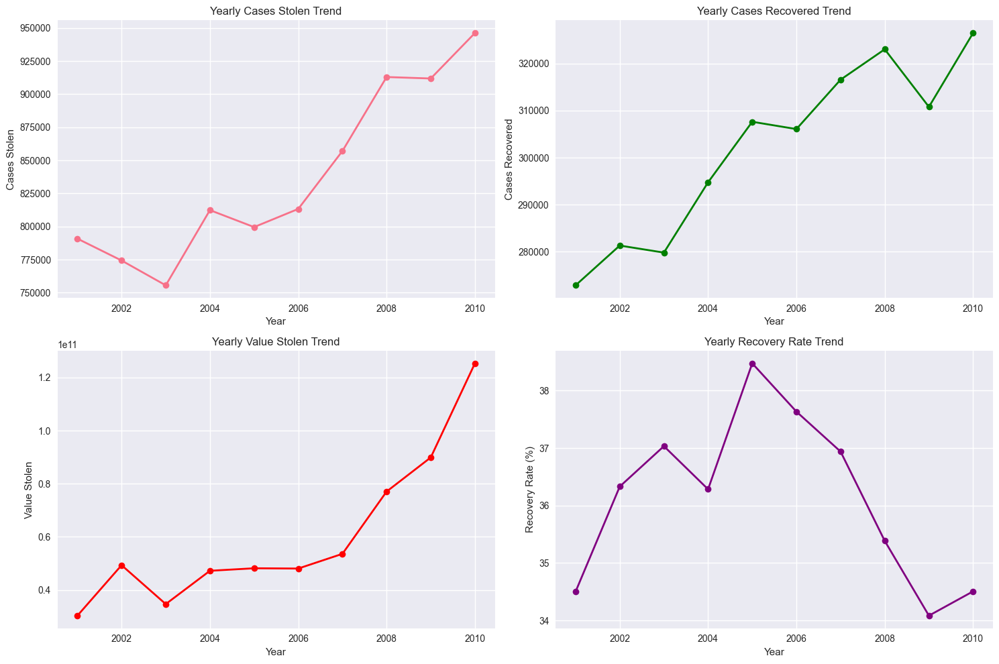

In [5]:
# Convert to Pandas for visualization (for this dataset size)
df_pd = df_clean.toPandas()

print("=== COMPREHENSIVE VISUALIZATION ANALYSIS ===")

# 1. CRIME TYPE DISTRIBUTION - Pie Chart and Bar Chart
print("\n1. Crime Type Distribution Analysis")

crime_type_summary = df_pd.groupby('Group_Name').agg({
    'Cases_Property_Stolen': 'sum',
    'Value_of_Property_Stolen': 'sum'
}).reset_index()

# Pie Chart - Cases by Crime Type
plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
plt.pie(crime_type_summary['Cases_Property_Stolen'], 
        labels=crime_type_summary['Group_Name'], 
        autopct='%1.1f%%', startangle=90)
plt.title('Distribution of Cases by Crime Type')

# Bar Chart - Cases by Crime Type
plt.subplot(1, 2, 2)
plt.bar(crime_type_summary['Group_Name'], crime_type_summary['Cases_Property_Stolen'])
plt.title('Cases Stolen by Crime Type')
plt.xticks(rotation=45)
plt.ylabel('Number of Cases')

plt.tight_layout()
plt.show()

# 2. YEARLY TRENDS - Line Charts
print("\n2. Yearly Trends Analysis")

yearly_trends_pd = df_pd.groupby('Year').agg({
    'Cases_Property_Stolen': 'sum',
    'Cases_Property_Recovered': 'sum',
    'Value_of_Property_Stolen': 'sum',
    'Value_of_Property_Recovered': 'sum'
}).reset_index()

fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Cases Stolen Trend
axes[0,0].plot(yearly_trends_pd['Year'], yearly_trends_pd['Cases_Property_Stolen'], marker='o', linewidth=2)
axes[0,0].set_title('Yearly Cases Stolen Trend')
axes[0,0].set_xlabel('Year')
axes[0,0].set_ylabel('Cases Stolen')

# Cases Recovered Trend
axes[0,1].plot(yearly_trends_pd['Year'], yearly_trends_pd['Cases_Property_Recovered'], marker='o', linewidth=2, color='green')
axes[0,1].set_title('Yearly Cases Recovered Trend')
axes[0,1].set_xlabel('Year')
axes[0,1].set_ylabel('Cases Recovered')

# Value Stolen Trend
axes[1,0].plot(yearly_trends_pd['Year'], yearly_trends_pd['Value_of_Property_Stolen'], marker='o', linewidth=2, color='red')
axes[1,0].set_title('Yearly Value Stolen Trend')
axes[1,0].set_xlabel('Year')
axes[1,0].set_ylabel('Value Stolen')

# Recovery Rate Trend
yearly_trends_pd['Recovery_Rate'] = (yearly_trends_pd['Cases_Property_Recovered'] / yearly_trends_pd['Cases_Property_Stolen']) * 100
axes[1,1].plot(yearly_trends_pd['Year'], yearly_trends_pd['Recovery_Rate'], marker='o', linewidth=2, color='purple')
axes[1,1].set_title('Yearly Recovery Rate Trend')
axes[1,1].set_xlabel('Year')
axes[1,1].set_ylabel('Recovery Rate (%)')

plt.tight_layout()
plt.show()


3. Regional Analysis


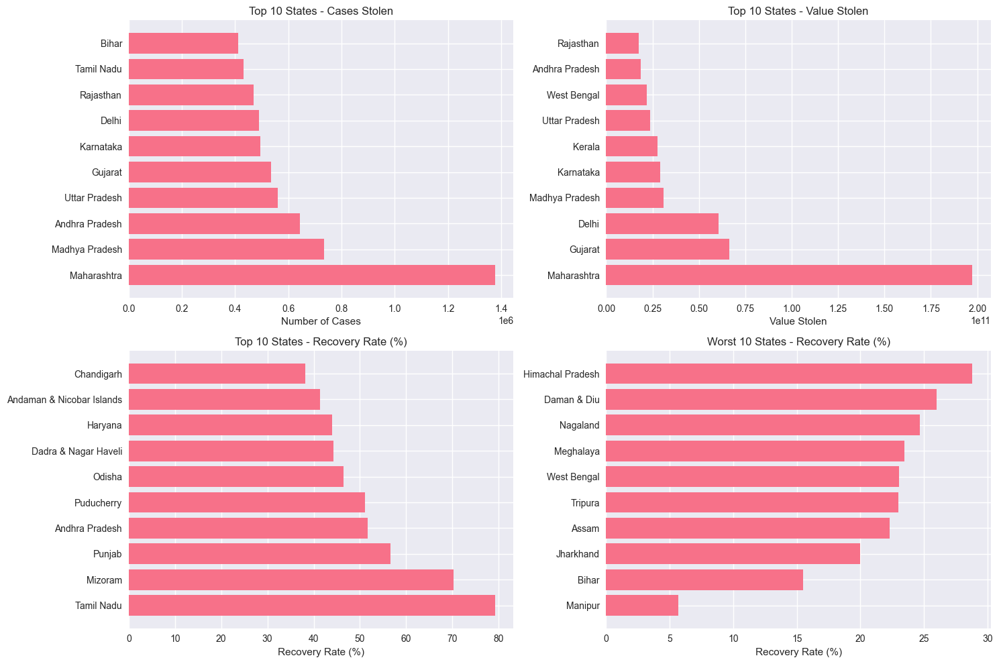


4. Heatmap Analysis


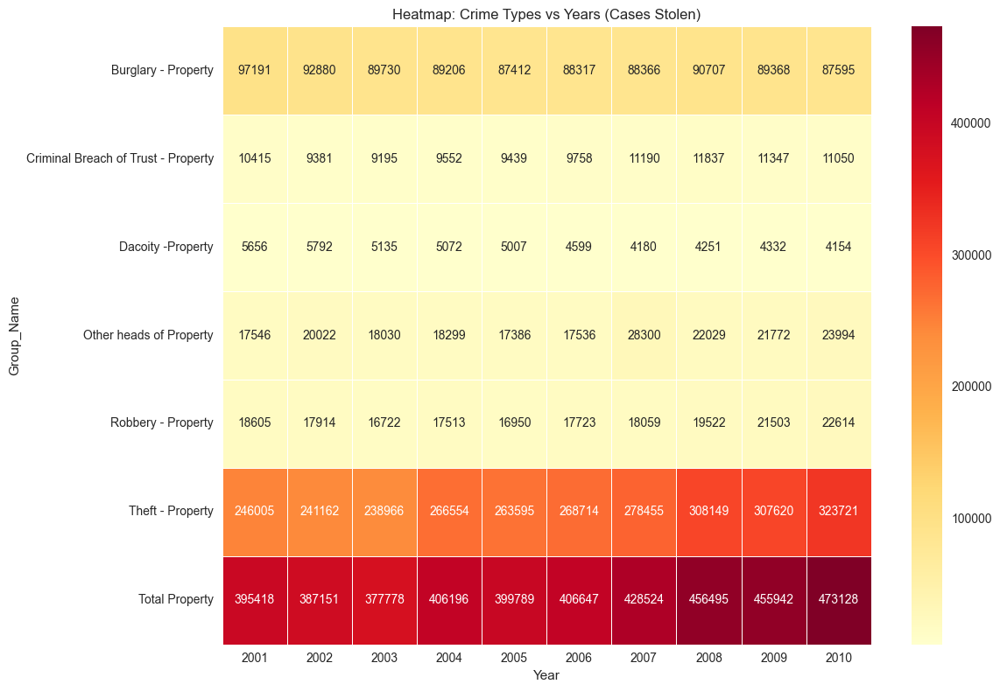

In [6]:
# 3. REGIONAL ANALYSIS - Bar Charts and Heatmaps
print("\n3. Regional Analysis")

# Top 10 States by Cases Stolen
state_stats = df_pd.groupby('Area_Name').agg({
    'Cases_Property_Stolen': 'sum',
    'Cases_Property_Recovered': 'sum',
    'Value_of_Property_Stolen': 'sum',
    'Value_of_Property_Recovered': 'sum'
}).reset_index()

state_stats['Recovery_Rate'] = (state_stats['Cases_Property_Recovered'] / state_stats['Cases_Property_Stolen']) * 100

# Top 10 States - Cases Stolen
top_10_states_cases = state_stats.nlargest(10, 'Cases_Property_Stolen')

plt.figure(figsize=(15, 10))

plt.subplot(2, 2, 1)
plt.barh(top_10_states_cases['Area_Name'], top_10_states_cases['Cases_Property_Stolen'])
plt.title('Top 10 States - Cases Stolen')
plt.xlabel('Number of Cases')

# Top 10 States - Value Stolen
top_10_states_value = state_stats.nlargest(10, 'Value_of_Property_Stolen')

plt.subplot(2, 2, 2)
plt.barh(top_10_states_value['Area_Name'], top_10_states_value['Value_of_Property_Stolen'])
plt.title('Top 10 States - Value Stolen')
plt.xlabel('Value Stolen')

# Recovery Rate by State (Top 10)
top_10_recovery = state_stats[state_stats['Cases_Property_Stolen'] > 1000].nlargest(10, 'Recovery_Rate')

plt.subplot(2, 2, 3)
plt.barh(top_10_recovery['Area_Name'], top_10_recovery['Recovery_Rate'])
plt.title('Top 10 States - Recovery Rate (%)')
plt.xlabel('Recovery Rate (%)')

# Worst 10 States - Recovery Rate
worst_10_recovery = state_stats[state_stats['Cases_Property_Stolen'] > 1000].nsmallest(10, 'Recovery_Rate')

plt.subplot(2, 2, 4)
plt.barh(worst_10_recovery['Area_Name'], worst_10_recovery['Recovery_Rate'])
plt.title('Worst 10 States - Recovery Rate (%)')
plt.xlabel('Recovery Rate (%)')

plt.tight_layout()
plt.show()

# 4. HEATMAP - Crime Types vs Years
print("\n4. Heatmap Analysis")

# Create pivot table for heatmap
crime_year_pivot = df_pd.pivot_table(
    values='Cases_Property_Stolen',
    index='Group_Name',
    columns='Year',
    aggfunc='sum',
    fill_value=0
)

plt.figure(figsize=(12, 8))
sns.heatmap(crime_year_pivot, annot=True, fmt='.0f', cmap='YlOrRd', linewidths=0.5)
plt.title('Heatmap: Crime Types vs Years (Cases Stolen)')
plt.tight_layout()
plt.show()

In [7]:
# BASIC DESCRIPTIVE STATISTICS - SIMPLIFIED VERSION
print("=== BASIC DESCRIPTIVE STATISTICS ===")

# Convert to Pandas for statistical analysis
df_pd = df_clean.toPandas()

# 1. Basic Statistics for Numerical Columns
numeric_columns = ['Cases_Property_Stolen', 'Cases_Property_Recovered', 
                  'Value_of_Property_Stolen', 'Value_of_Property_Recovered']

print("1. BASIC DESCRIPTIVE STATISTICS:")
basic_stats = df_pd[numeric_columns].describe()
print(basic_stats)

# 2. Additional Statistical Measures - SIMPLIFIED
from scipy import stats
import numpy as np

print("\n2. ADDITIONAL STATISTICAL MEASURES:")
for col in numeric_columns:
    print(f"\n--- {col} ---")
    data = df_pd[col].dropna()  # Remove NaN values for safety
    
    # Use pandas mode which is more reliable
    mode_values = data.mode()
    if len(mode_values) > 0:
        mode_str = f"{mode_values.iloc[0]:.2f}" 
        if len(mode_values) > 1:
            mode_str += f" (multiple modes)"
    else:
        mode_str = "No mode"
    
    print(f"Count: {len(data):,}")
    print(f"Mean: {data.mean():.2f}")
    print(f"Median: {data.median():.2f}")
    print(f"Mode: {mode_str}")
    print(f"Standard Deviation: {data.std():.2f}")
    print(f"Variance: {data.var():.2f}")
    print(f"Minimum: {data.min():.2f}")
    print(f"Maximum: {data.max():.2f}")
    print(f"Range: {data.max() - data.min():.2f}")
    
    # Coefficient of Variation
    if data.mean() != 0:
        cv = (data.std() / data.mean()) * 100
        print(f"Coefficient of Variation: {cv:.2f}%")
    else:
        print(f"Coefficient of Variation: N/A")
    
    # Skewness and Kurtosis
    print(f"Skewness: {stats.skew(data):.4f}")
    print(f"Kurtosis: {stats.kurtosis(data):.4f}")
    
    # Quartiles
    Q1 = data.quantile(0.25)
    Q3 = data.quantile(0.75)
    print(f"Q1 (25th percentile): {Q1:.2f}")
    print(f"Q3 (75th percentile): {Q3:.2f}")
    print(f"IQR (Q3 - Q1): {Q3 - Q1:.2f}")

=== BASIC DESCRIPTIVE STATISTICS ===
1. BASIC DESCRIPTIVE STATISTICS:
       Cases_Property_Stolen  Cases_Property_Recovered  \
count            2449.000000               2449.000000   
mean             3419.420988               1232.892201   
std              8136.256820               3079.573907   
min                 0.000000                  0.000000   
25%                45.000000                 13.000000   
50%               358.000000                113.000000   
75%              1875.000000                722.000000   
max             80663.000000              27960.000000   

       Value_of_Property_Stolen  Value_of_Property_Recovered  
count              2.449000e+03                 2.449000e+03  
mean               2.465431e+08                 5.859924e+07  
std                9.670035e+08                 2.494403e+08  
min                0.000000e+00                 0.000000e+00  
25%                3.649018e+06                 6.845700e+05  
50%                2.701800e+


5. Correlation Analysis


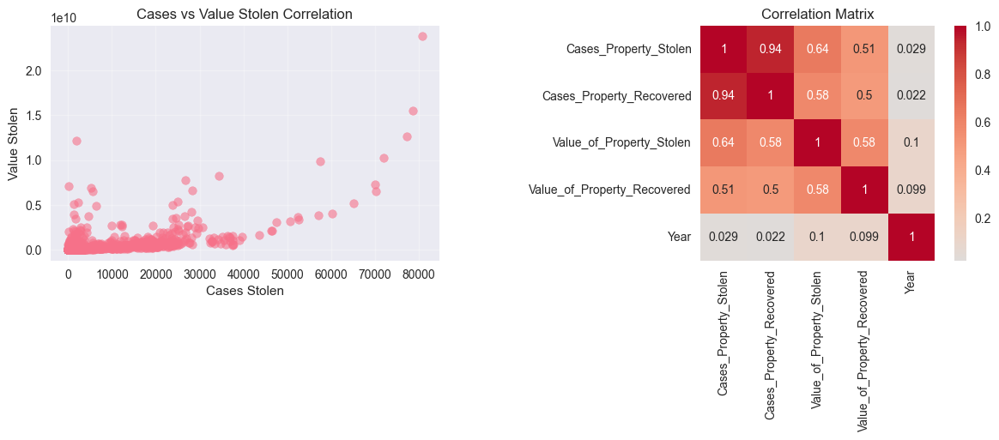


6. Distribution Analysis


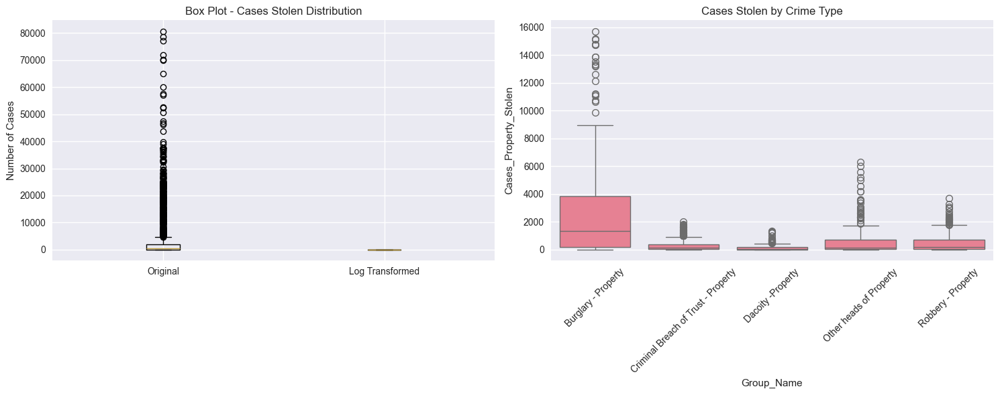

In [8]:
# 5. SCATTER PLOTS and CORRELATION MATRIX
print("\n5. Correlation Analysis")

# Scatter Plot: Cases Stolen vs Value Stolen
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.scatter(df_pd['Cases_Property_Stolen'], df_pd['Value_of_Property_Stolen'], alpha=0.6)
plt.xlabel('Cases Stolen')
plt.ylabel('Value Stolen')
plt.title('Cases vs Value Stolen Correlation')
plt.grid(True, alpha=0.3)

# Correlation Matrix Heatmap
plt.subplot(1, 2, 2)
numeric_cols_for_corr = ['Cases_Property_Stolen', 'Cases_Property_Recovered', 
                        'Value_of_Property_Stolen', 'Value_of_Property_Recovered', 'Year']
correlation_matrix = df_pd[numeric_cols_for_corr].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, square=True)
plt.title('Correlation Matrix')

plt.tight_layout()
plt.show()

# 6. BOX PLOTS - Distribution Analysis
print("\n6. Distribution Analysis")

plt.figure(figsize=(15, 6))

plt.subplot(1, 2, 1)
df_pd['Cases_Property_Stolen_log'] = np.log1p(df_pd['Cases_Property_Stolen'])
plt.boxplot([df_pd['Cases_Property_Stolen'], df_pd['Cases_Property_Stolen_log']])
plt.xticks([1, 2], ['Original', 'Log Transformed'])
plt.title('Box Plot - Cases Stolen Distribution')
plt.ylabel('Number of Cases')

plt.subplot(1, 2, 2)
crime_types_to_plot = df_pd['Group_Name'].value_counts().index[:5]
filtered_data = df_pd[df_pd['Group_Name'].isin(crime_types_to_plot)]
sns.boxplot(data=filtered_data, x='Group_Name', y='Cases_Property_Stolen')
plt.xticks(rotation=45)
plt.title('Cases Stolen by Crime Type')
plt.tight_layout()
plt.show()

In [9]:
# 7. INTERACTIVE VISUALIZATIONS WITH PLOTLY
print("\n7. Interactive Visualizations")

# Interactive Bar Chart - Top States
fig = px.bar(top_10_states_cases, 
             x='Cases_Property_Stolen', 
             y='Area_Name',
             orientation='h',
             title='Top 10 States by Cases Stolen (Interactive)',
             color='Cases_Property_Stolen',
             color_continuous_scale='Viridis')
fig.show()

# Interactive Pie Chart - Crime Type Distribution
fig = px.pie(crime_type_summary, 
             values='Cases_Property_Stolen', 
             names='Group_Name',
             title='Crime Type Distribution (Interactive)')
fig.show()

# Interactive Line Chart - Yearly Trends
fig = go.Figure()
fig.add_trace(go.Scatter(x=yearly_trends_pd['Year'], 
                        y=yearly_trends_pd['Cases_Property_Stolen'],
                        mode='lines+markers',
                        name='Cases Stolen',
                        line=dict(width=3)))
fig.add_trace(go.Scatter(x=yearly_trends_pd['Year'], 
                        y=yearly_trends_pd['Cases_Property_Recovered'],
                        mode='lines+markers',
                        name='Cases Recovered',
                        line=dict(width=3)))
fig.update_layout(title='Yearly Crime Trends (Interactive)',
                 xaxis_title='Year',
                 yaxis_title='Number of Cases')
fig.show()

# Interactive Scatter Plot
fig = px.scatter(df_pd, 
                x='Cases_Property_Stolen', 
                y='Value_of_Property_Stolen',
                color='Group_Name',
                size='Cases_Property_Recovered',
                hover_data=['Area_Name', 'Year'],
                title='Interactive Scatter: Cases vs Value Stolen')
fig.show()


7. Interactive Visualizations



8. Advanced Analytics Visualizations


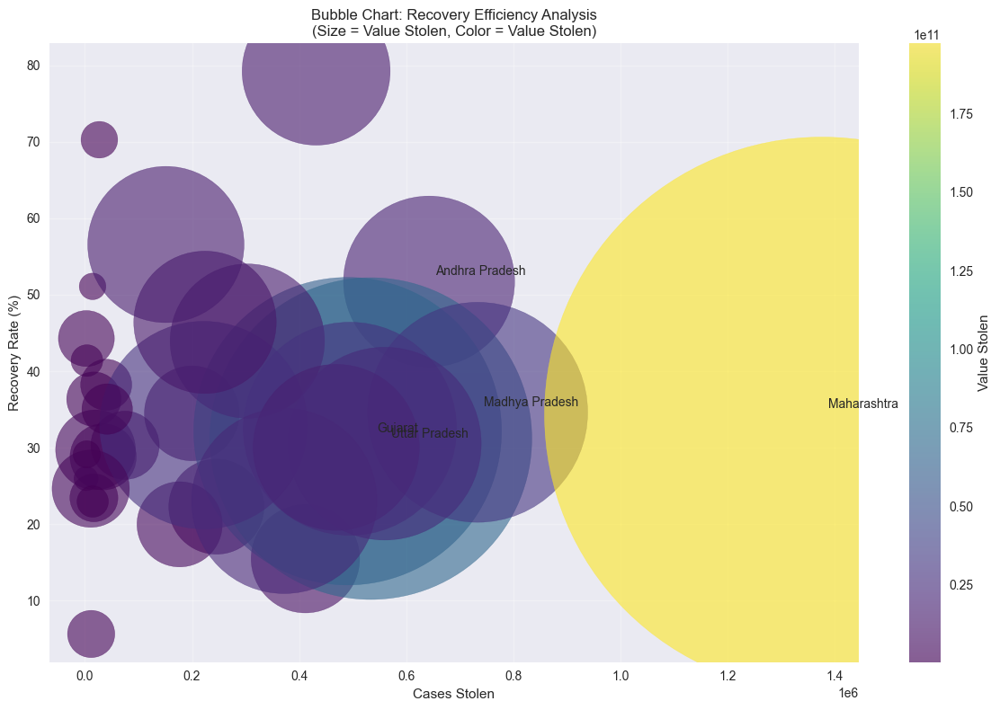


9. Stacked Bar Chart Analysis


<Figure size 1500x800 with 0 Axes>

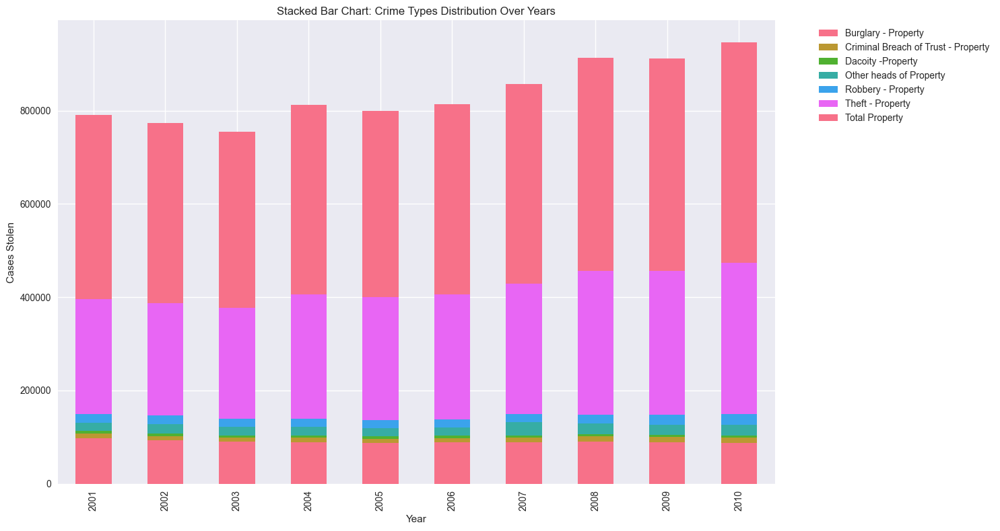

In [10]:
# 8. ADVANCED ANALYTICS VISUALIZATIONS
print("\n8. Advanced Analytics Visualizations")

# Recovery Efficiency Analysis
state_stats_filtered = state_stats[state_stats['Cases_Property_Stolen'] > 1000]

# Bubble Chart: Cases vs Recovery Rate
plt.figure(figsize=(12, 8))
scatter = plt.scatter(state_stats_filtered['Cases_Property_Stolen'], 
                     state_stats_filtered['Recovery_Rate'],
                     s=state_stats_filtered['Value_of_Property_Stolen']/1000000,  # Size by value
                     alpha=0.6,
                     c=state_stats_filtered['Value_of_Property_Stolen'],
                     cmap='viridis')

plt.colorbar(scatter, label='Value Stolen')
plt.xlabel('Cases Stolen')
plt.ylabel('Recovery Rate (%)')
plt.title('Bubble Chart: Recovery Efficiency Analysis\n(Size = Value Stolen, Color = Value Stolen)')
plt.grid(True, alpha=0.3)

# Add state labels for top states
for i, row in state_stats_filtered.nlargest(5, 'Cases_Property_Stolen').iterrows():
    plt.annotate(row['Area_Name'], 
                (row['Cases_Property_Stolen'], row['Recovery_Rate']),
                xytext=(5, 5), textcoords='offset points')

plt.tight_layout()
plt.show()

# 9. STACKED BAR CHART - Crime Types Over Years
print("\n9. Stacked Bar Chart Analysis")

year_crime_type = df_pd.groupby(['Year', 'Group_Name'])['Cases_Property_Stolen'].sum().reset_index()
pivot_data = year_crime_type.pivot(index='Year', columns='Group_Name', values='Cases_Property_Stolen').fillna(0)

plt.figure(figsize=(15, 8))
pivot_data.plot(kind='bar', stacked=True, figsize=(15, 8))
plt.title('Stacked Bar Chart: Crime Types Distribution Over Years')
plt.xlabel('Year')
plt.ylabel('Cases Stolen')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


10. Statistical Visualizations


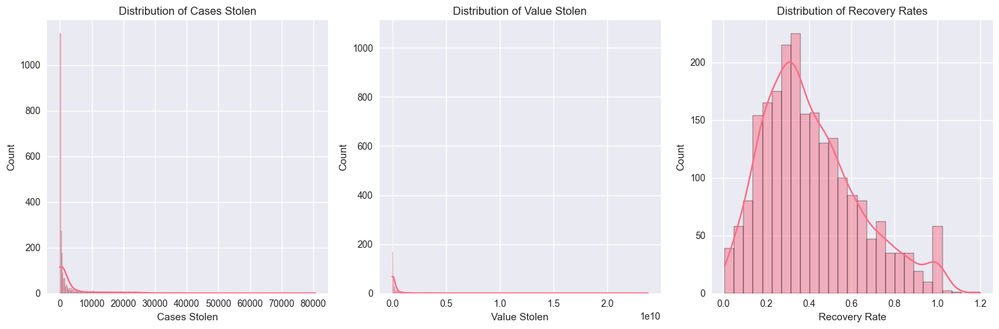

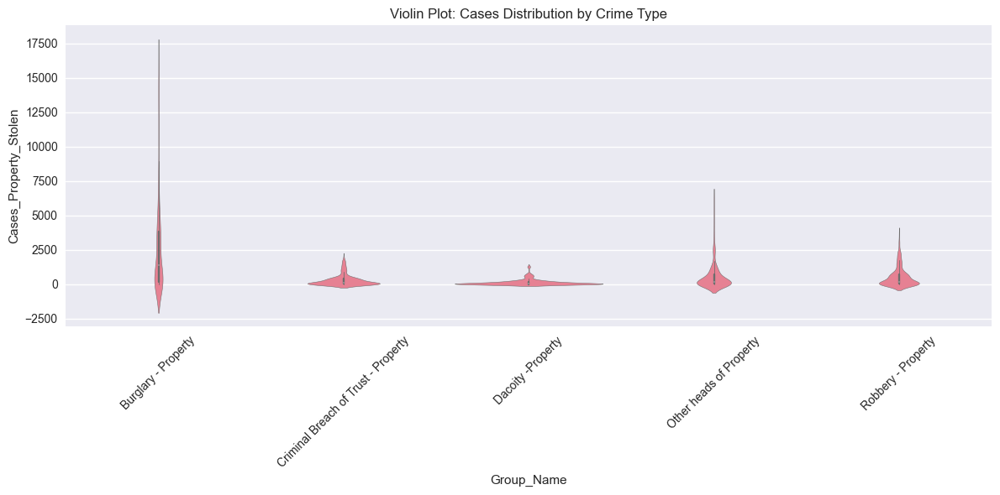

In [11]:
# 10. STATISTICAL VISUALIZATIONS
print("\n10. Statistical Visualizations")

# Histogram with KDE
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
sns.histplot(data=df_pd, x='Cases_Property_Stolen', kde=True)
plt.title('Distribution of Cases Stolen')
plt.xlabel('Cases Stolen')

plt.subplot(1, 3, 2)
sns.histplot(data=df_pd, x='Value_of_Property_Stolen', kde=True)
plt.title('Distribution of Value Stolen')
plt.xlabel('Value Stolen')

plt.subplot(1, 3, 3)
recovery_rates = df_pd[df_pd['Recovery_Rate_Cases'] > 0]['Recovery_Rate_Cases']
sns.histplot(data=recovery_rates, kde=True)
plt.title('Distribution of Recovery Rates')
plt.xlabel('Recovery Rate')

plt.tight_layout()
plt.show()

# Violin Plots
plt.figure(figsize=(12, 6))
top_5_crimes = df_pd['Group_Name'].value_counts().index[:5]
filtered_violin = df_pd[df_pd['Group_Name'].isin(top_5_crimes)]
sns.violinplot(data=filtered_violin, x='Group_Name', y='Cases_Property_Stolen')
plt.title('Violin Plot: Cases Distribution by Crime Type')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


11. Dashboard-Style Comprehensive Visualization


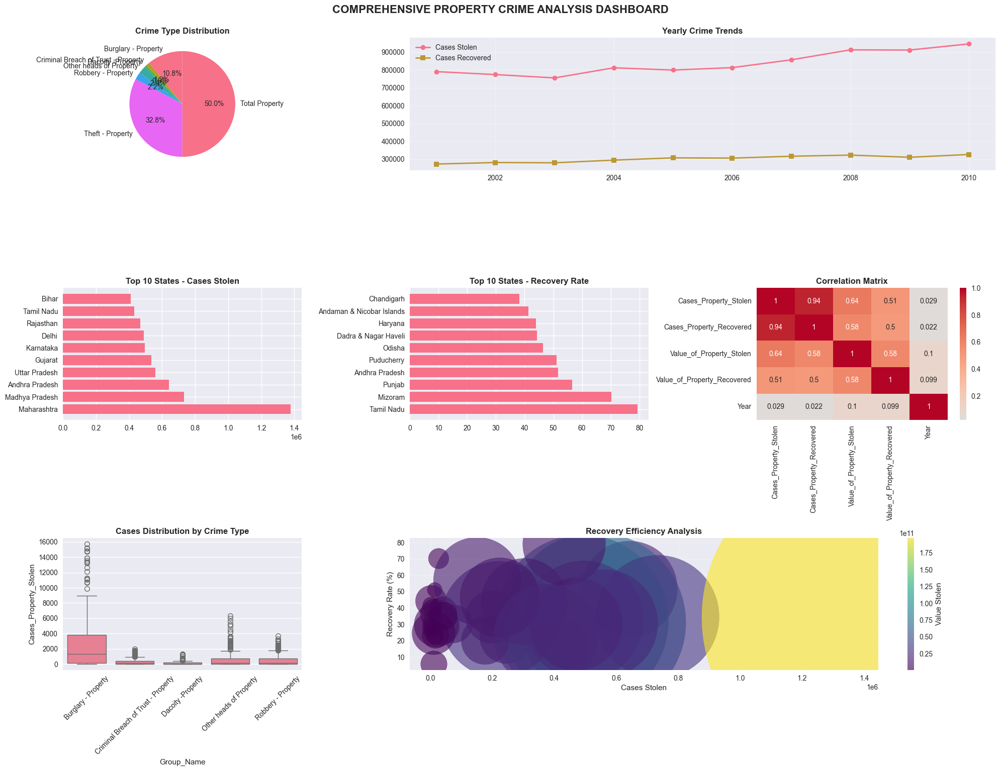

In [12]:
# 11. DASHBOARD-STYLE COMPREHENSIVE VISUALIZATION
print("\n11. Dashboard-Style Comprehensive Visualization")

# Create a comprehensive dashboard
fig = plt.figure(figsize=(20, 15))

# Define subplot grid
gs = fig.add_gridspec(3, 3)

# 1. Crime Type Distribution (Pie)
ax1 = fig.add_subplot(gs[0, 0])
wedges, texts, autotexts = ax1.pie(crime_type_summary['Cases_Property_Stolen'], 
                                  labels=crime_type_summary['Group_Name'],
                                  autopct='%1.1f%%', startangle=90)
ax1.set_title('Crime Type Distribution', fontsize=12, fontweight='bold')

# 2. Yearly Trend (Line)
ax2 = fig.add_subplot(gs[0, 1:])
ax2.plot(yearly_trends_pd['Year'], yearly_trends_pd['Cases_Property_Stolen'], 
         marker='o', linewidth=2, label='Cases Stolen')
ax2.plot(yearly_trends_pd['Year'], yearly_trends_pd['Cases_Property_Recovered'], 
         marker='s', linewidth=2, label='Cases Recovered')
ax2.set_title('Yearly Crime Trends', fontsize=12, fontweight='bold')
ax2.legend()
ax2.grid(True, alpha=0.3)

# 3. Top States (Bar)
ax3 = fig.add_subplot(gs[1, 0])
ax3.barh(top_10_states_cases['Area_Name'], top_10_states_cases['Cases_Property_Stolen'])
ax3.set_title('Top 10 States - Cases Stolen', fontsize=12, fontweight='bold')

# 4. Recovery Rate by State (Bar)
ax4 = fig.add_subplot(gs[1, 1])
ax4.barh(top_10_recovery['Area_Name'], top_10_recovery['Recovery_Rate'])
ax4.set_title('Top 10 States - Recovery Rate', fontsize=12, fontweight='bold')

# 5. Correlation Heatmap
ax5 = fig.add_subplot(gs[1, 2])
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, ax=ax5)
ax5.set_title('Correlation Matrix', fontsize=12, fontweight='bold')

# 6. Box Plot
ax6 = fig.add_subplot(gs[2, 0])
sns.boxplot(data=filtered_data, x='Group_Name', y='Cases_Property_Stolen', ax=ax6)
ax6.set_title('Cases Distribution by Crime Type', fontsize=12, fontweight='bold')
ax6.tick_params(axis='x', rotation=45)

# 7. Scatter Plot
ax7 = fig.add_subplot(gs[2, 1:])
scatter = ax7.scatter(state_stats_filtered['Cases_Property_Stolen'], 
                     state_stats_filtered['Recovery_Rate'],
                     s=state_stats_filtered['Value_of_Property_Stolen']/1000000,
                     alpha=0.6,
                     c=state_stats_filtered['Value_of_Property_Stolen'],
                     cmap='viridis')
plt.colorbar(scatter, ax=ax7, label='Value Stolen')
ax7.set_xlabel('Cases Stolen')
ax7.set_ylabel('Recovery Rate (%)')
ax7.set_title('Recovery Efficiency Analysis', fontsize=12, fontweight='bold')
ax7.grid(True, alpha=0.3)

plt.tight_layout()
plt.suptitle('COMPREHENSIVE PROPERTY CRIME ANALYSIS DASHBOARD', 
             fontsize=16, fontweight='bold', y=1.02)
plt.show()

In [13]:
from pyspark.sql.functions import col, sum, desc
print("\n=== UPDATING DATA ===")
# Alternative with manual rounding calculation
df_updated = df.withColumn(
    "Recovery_Rate", 
    ((col("Cases_Property_Recovered") / col("Cases_Property_Stolen")) * 100).cast("decimal(10,2)")
)
print("Added Recovery_Rate column")
print("Updated data sample:")
df_updated.select("Area_Name", "Year", "Cases_Property_Stolen", "Cases_Property_Recovered", "Recovery_Rate").show(10)


=== UPDATING DATA ===
Added Recovery_Rate column
Updated data sample:
+--------------------+----+---------------------+------------------------+-------------+
|           Area_Name|Year|Cases_Property_Stolen|Cases_Property_Recovered|Recovery_Rate|
+--------------------+----+---------------------+------------------------+-------------+
|Andaman & Nicobar...|2001|                   64|                      27|        42.19|
|      Andhra Pradesh|2001|                 7134|                    3321|        46.55|
|   Arunachal Pradesh|2001|                  248|                      66|        26.61|
|               Assam|2001|                 2423|                     539|        22.25|
|               Bihar|2001|                 3231|                     367|        11.36|
|          Chandigarh|2001|                  364|                     119|        32.69|
|        Chhattisgarh|2001|                 4144|                    1169|        28.21|
|Dadra & Nagar Haveli|2001|            

In [14]:
print("\n=== FILTERING HIGHEST CASES ===")

# Find states with highest total cases stolen
highest_cases = df_updated.groupBy("Area_Name") \
    .agg(sum("Cases_Property_Stolen").alias("Total_Cases_Stolen")) \
    .orderBy(desc("Total_Cases_Stolen")) \
    .limit(20)

print("Top 20 States with Highest Cases Stolen:")
highest_cases.show()


=== FILTERING HIGHEST CASES ===
Top 20 States with Highest Cases Stolen:
+---------------+------------------+
|      Area_Name|Total_Cases_Stolen|
+---------------+------------------+
|    Maharashtra|           1376814|
| Madhya Pradesh|            733524|
| Andhra Pradesh|            642822|
|  Uttar Pradesh|            559970|
|        Gujarat|            534060|
|      Karnataka|            494968|
|          Delhi|            490694|
|      Rajasthan|            469468|
|     Tamil Nadu|            431864|
|          Bihar|            411840|
|    West Bengal|            372226|
|        Haryana|            303336|
|          Assam|            245560|
|         Odisha|            224280|
|         Kerala|            221652|
|   Chhattisgarh|            199712|
|      Jharkhand|            176868|
|         Punjab|            151182|
|Jammu & Kashmir|             74906|
|    Uttarakhand|             41530|
+---------------+------------------+



In [18]:
print("=== EASY EXPORT METHOD ===")

# Convert to Pandas and save as CSV
highest_cases_pd = highest_cases.toPandas()

# Save to your desired location
export_path = r"C:\Users\monis_bfv4s0d\Desktop\crime_results.csv"
highest_cases_pd.to_csv(export_path, index=False)

print(f"✅ Data exported as CSV to: {export_path}")
print("🎉 DONE! File saved successfully.")

=== EASY EXPORT METHOD ===
✅ Data exported as CSV to: C:\Users\monis_bfv4s0d\Desktop\crime_results.csv
🎉 DONE! File saved successfully.


## 📋 Conclusion :

This comprehensive analysis of property crime data across India from 2001 to 2010 has successfully demonstrated the power of Big Data Analytics in understanding crime patterns and law enforcement effectiveness. Through our systematic approach using PySpark, we were able to process and analyze large-scale crime data, revealing valuable insights about regional crime variations, recovery efficiency, and temporal trends.

Our analysis identified key states with the highest property crime incidence and uncovered significant variations in recovery rates across different regions. The project successfully calculated recovery efficiency metrics, compared crime patterns across different categories, and tracked how these patterns evolved over the decade. The technical implementation showcased how distributed computing frameworks like PySpark can efficiently handle large datasets while providing meaningful analytical outcomes.

The findings from this project provide actionable intelligence that can assist law enforcement agencies in resource allocation, help policy makers in developing targeted crime prevention strategies, and offer the public valuable insights into property crime trends across India. The methodologies developed can be extended to analyze more recent data or applied to other types of crime datasets, making this project a solid foundation for ongoing crime analytics initiatives.

Ultimately, this project highlights how data-driven approaches can transform raw crime statistics into meaningful insights that contribute to public safety and more effective law enforcement strategies across the country.